# Compare methods with optimize parameters in ref_case

In [1]:
import xarray as xr
import pandas as pd
import numpy as np

import hvplot.xarray
import hvplot.pandas

import matplotlib.pyplot as plt
from cycler import cycler

from sstats import signals as sg
from sstats import sigp as sigp
from sstats import tseries as ts
from sstats import get_cmap_colors

import hvplot.xarray
import hvplot.pandas
import holoviews as hv

import pynsitu as pyn
import lib as lib
from lib import KEYS, raw_dir
import os
from glob import glob

import synthetic_traj as st

from synthetic_traj import synthetic_traj, noise_irregular_sampling, ref_case, typical_case

/Users/mdemol/opt/anaconda3/envs/mdenv/lib/python3.9/site-packages/pyTMD/tools.py:55: UserWarning: ipyleaflet not available
  warnings.warn("ipyleaflet not available")
/Users/mdemol/opt/anaconda3/envs/mdenv/lib/python3.9/site-packages/pyTMD/tools.py:56: UserWarning: Some functions will throw an exception if called
  warnings.warn("Some functions will throw an exception if called")


In [7]:
def ms_diff(DF, true_key, var = ['x', 'y', 'u','v','ax', 'ay', 'X', 'U', 'Axy']):
    DF = DF.copy()
    dft = DF[true_key]
    dft_ = (dft.set_index('id')[var]).groupby('id').var()
    dfms  = pd.DataFrame(index = DF.keys(), columns = var)
    dfmsr = pd.DataFrame(index = DF.keys(), columns = var)
    for l in DF :
        df = DF[l]
        if np.all(df.index.values == dft.index.values):
            df_ = df.set_index('id')[var]-dft.set_index('id')[var]
            #dfr_ = (df.set_index('id')[var]-dft.set_index('id')[var])/dft.set_index('id')[var]
            dfms.loc[l] = df_.groupby('id').var().mean()
            dfmsr.loc[l] = (df_.groupby('id').var()/dft_).mean()
        else : 
            print(l + ' has not the same time index')
            continue
    dfms = pd.concat([dfms, dfmsr.rename(columns = {v : 'ratio_'+v for v in var})], axis=1).dropna()
    return dfms

___________
# Reference case + spectral_diff

In [2]:
N=100
acc_cut = 1e-3
position_noise=20
ntype = 'white_noise'
offset_type = 'svp_scripps_10'
dt_smooth = '30min'
true_key = 'True_'+dt_smooth
spectral_diff = True
ref_case['spectral_diff'] = spectral_diff
print(ref_case)

{'T': 5, 'U_low': 0.3, 'U_ni': 0.2, 'U_2': 0, 'U_1': 0, 'tau_eta': 0.1, 'n_layers': 5, 'spectral_diff': True}


In [3]:
DF = dict()

# TRUE
t = (50, '1min') # use it instead of (50, 1/24/60 because otherwise not regularly sampled
dst = synthetic_traj(t, N , **ref_case)# u,v, ax, ay computed
dft = st.dataset2dataframe(dst).rename(columns={'draw':'id'})
DF['True_1min'] = dft

#OBSERVED

dso = noise_irregular_sampling(dst, t, position_noise, ntype=ntype, offset_type=offset_type, istart=9214)
dfo = st.dataset2dataframe(dso).rename(columns={'draw':'id'})
dfo = dfo.groupby('id').apply(pyn.geo.compute_dt, time='index')

DF['Observed'] = dfo

# Interpolated True
dsti = dst.interp(time = pd.date_range(dfo.index.min(), dfo.index.max(), freq=dt_smooth))
dsti['dt']=dsti.time.diff('time')/pd.Timedelta('1s')
dfti = st.dataset2dataframe(dsti).rename(columns={'draw':'id'})

DF['True_'+dt_smooth] = dfti

spectral_diff
-13394.138093270494
9214


In [4]:
parameters_var = dict(acc_cut=1e-3,
                         position_error=20,
                         acceleration_amplitude = 1e-5,
                         acceleration_T = 5.5*86400,
                         time_chunk=2,
                         acc_cut_key = ('ax', 'ay', 'Axy'))
parameters_lowess = dict(degree=2)
parameters_spydell = dict(nb_pt_mean=5)


dfl = pyn.drifters.smooth_all(dfo, 'lowess', dt_smooth, parameters = parameters_lowess, spectral_diff = spectral_diff, geo=False)
dfv = pyn.drifters.smooth_all(dfo, 'variational', dt_smooth, parameters = parameters_var, spectral_diff = spectral_diff, geo=False)
dfs = pyn.drifters.smooth_all(dfo, 'spydell', dt_smooth, parameters = parameters_spydell, spectral_diff = spectral_diff, geo=False)

DF['LOWESS'] = dfl
DF['Variational']=dfv
DF['Spydell']=dfs

0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0

In [5]:
d=0
st.hvplot_DF(DF, d, ['x', 'y', 'u','v','ax', 'ay'])

6


:Layout
   .Overlay.I   :Overlay
      .Curve.True_1min.I  :Curve   [time]   (x)
      .Curve.True_1min.II :Curve   [time]   (x)
      .Curve.Observed     :Curve   [time]   (x)
      .Curve.True_30min   :Curve   [time]   (x)
      .Curve.LOWESS       :Curve   [time]   (x)
      .Curve.Variational  :Curve   [time]   (x)
      .Curve.Spydell      :Curve   [time]   (x)
   .Overlay.II  :Overlay
      .Curve.True_1min.I  :Curve   [time]   (y)
      .Curve.True_1min.II :Curve   [time]   (y)
      .Curve.Observed     :Curve   [time]   (y)
      .Curve.True_30min   :Curve   [time]   (y)
      .Curve.LOWESS       :Curve   [time]   (y)
      .Curve.Variational  :Curve   [time]   (y)
      .Curve.Spydell      :Curve   [time]   (y)
   .Overlay.III :Overlay
      .Curve.True_1min.I  :Curve   [time]   (u)
      .Curve.True_1min.II :Curve   [time]   (u)
      .Curve.Observed     :Curve   [time]   (u)
      .Curve.True_30min   :Curve   [time]   (u)
      .Curve.LOWESS       :Curve   [time]   (u)
      .Curve.Variational  :Curve   [time]   (u)
      .Curve.Spydell      :Curve   [time]   (u)
   .Overlay.IV  :Overlay
      .Curve.True_1min.I  :Curve   [time]   (v)
      .Curve.True_1min.II :Curve   [time]   (v)
      .Curve.Observed     :Curve   [time]   (v)
      .Curve.True_30min   :Curve   [time]   (v)
      .Curve.LOWESS       :Curve   [time]   (v)
      .Curve.Variational  :Curve   [time]   (v)
      .Curve.Spydell      :Curve   [time]   (v)
   .Overlay.V   :Overlay
      .Curve.True_1min.I  :Curve   [time]   (ax)
      .Curve.True_1min.II :Curve   [time]   (ax)
      .Curve.Observed     :Curve   [time]   (ax)
      .Curve.True_30min   :Curve   [time]   (ax)
      .Curve.LOWESS       :Curve   [time]   (ax)
      .Curve.Variational  :Curve   [time]   (ax)
      .Curve.Spydell      :Curve   [time]   (ax)
   .Overlay.VI  :Overlay
      .Curve.True_1min.I  :Curve   [time]   (ay)
      .Curve.True_1min.II :Curve   [time]   (ay)
      .Curve.Observed     :Curve   [time]   (ay)
      .Curve.True_30min   :Curve   [time]   (ay)
      .Curve.LOWESS       :Curve   [time]   (ay)
      .Curve.Variational  :Curve   [time]   (ay)
      .Curve.Spydell      :Curve   [time]   (ay)

In [15]:
dfms

,x,y,u,v,ax,ay,X,U,Axy,ratio_x,ratio_y,ratio_u,ratio_v,ratio_ax,ratio_ay,ratio_X,ratio_U,ratio_Axy
True_30min,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000
LOWESS,539.811611,526.391700,0.000130,0.000129,2.108762e-09,2.102640e-09,707.411415,0.000129,1.454376e-09,2.113689e-08,1.867942e-08,0.001180,0.001171,1.085032,1.074250,1.842548e-08,0.002491,1.773728
Variational,38014.073161,37800.829164,0.000396,0.000380,2.063394e-09,2.037833e-09,38907.564132,0.000344,1.534711e-09,1.476267e-06,1.437745e-06,0.003598,0.003450,1.055541,1.042686,1.067274e-06,0.006531,1.870477
Spydell,772150.833433,849857.239655,0.000222,0.000221,1.997721e-09,1.987423e-09,750874.038042,0.000218,1.336617e-09,2.887439e-05,3.388248e-05,0.002014,0.002008,1.023891,1.013414,1.848858e-05,0.004195,1.626809


In [13]:
dfms = ms_diff(DF, true_key='True_'+dt_smooth).astype(float)
dfr = dfms[[l for l in dfms.columns if 'ratio_' in l]]
dfr =dfr.rename(columns = {l:l.replace('ratio_','') for l in dfr.columns})*100

True_1min has not the same time index
Observed has not the same time index


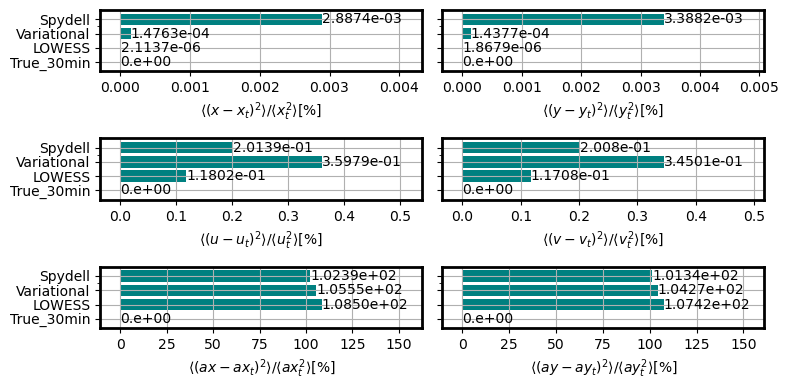

In [18]:
fig, axs = plt.subplots(3,2, sharey=True, figsize = (8,4))
i=0
axs = axs.flatten()
for var in ['x', 'y', 'u','v','ax','ay'] : 
    ax=axs[i]
    dfr[var].plot.barh(ax=ax, color ='teal', width =0.8)
    ax.grid()
    ax.set_xlim(-0.1*dfr[var].max(), dfr[var].max()*1.5)
    i+=1
    ax.set_xlabel(fr'$\langle ({var}-{var}_t)^2 \rangle / \langle {var}_t^2 \rangle [\%]$')
    ax.bar_label(ax.containers[0], labels =[ np.format_float_scientific(l,precision = 4, exp_digits=2) for l in dfr[var].values])
fig.tight_layout()

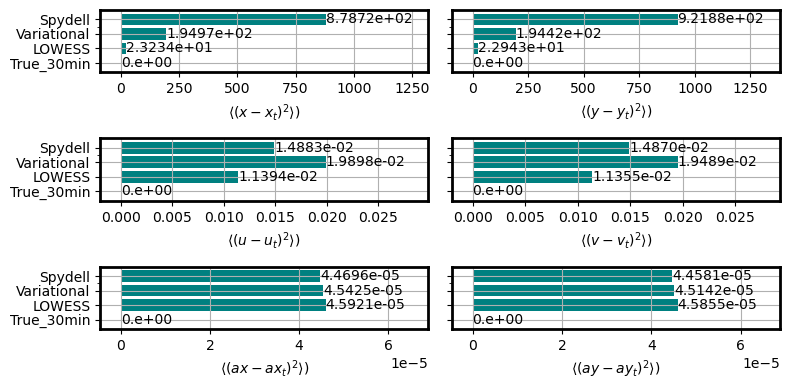

In [19]:
fig, axs = plt.subplots(3,2, sharey=True, figsize = (8,4))
i=0
axs = axs.flatten()
for var in ['x', 'y', 'u','v','ax','ay'] : 
    ax=axs[i]
    np.sqrt(dfms[var]).plot.barh(ax=ax, color ='teal', width =0.8)
    ax.grid()
    ax.set_xlim(-0.1*np.sqrt(dfms[var]).max(), np.sqrt(dfms[var]).max()*1.5)
    i+=1
    ax.set_xlabel(fr'$\langle ({var}-{var}_t)^2 \rangle)$')
    ax.bar_label(ax.containers[0], labels =[ np.format_float_scientific(l,precision = 4, exp_digits=2) for l in np.sqrt(dfms[var]).values])
fig.tight_layout()

True_30min
LOWESS
Variational
Spydell


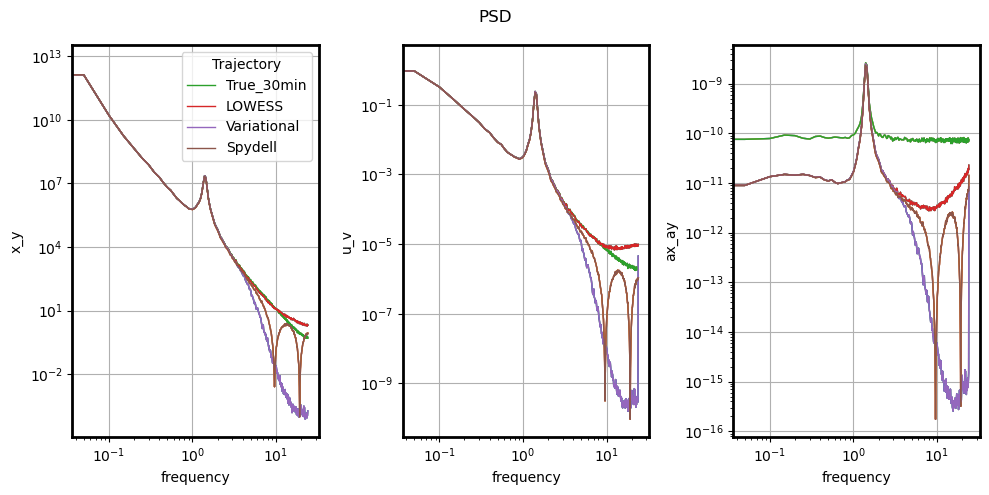

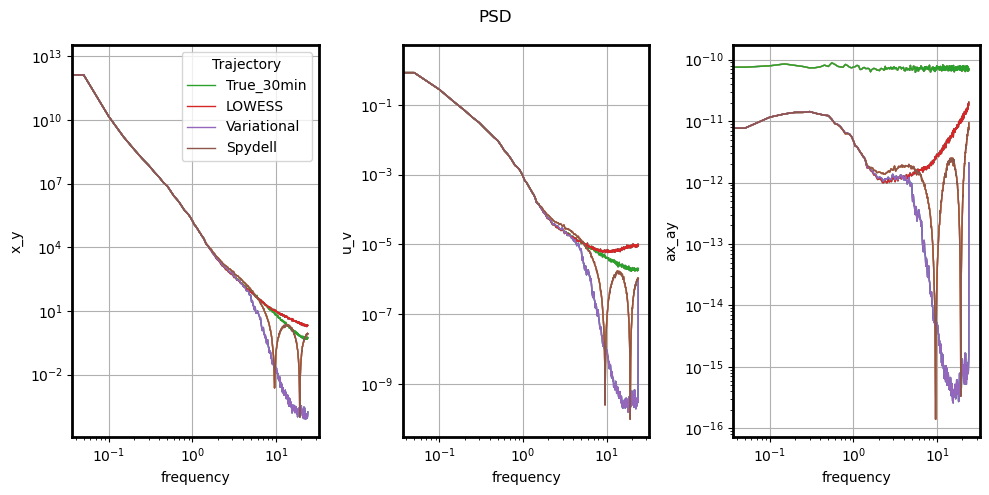

In [9]:
DF.pop('True_1min')
DSE = st.spectrum_DF(DF, nperseg='20D', detrend = 'linear')
dse = st.DSE2dse(DSE)
dsen, dsep = st.negpos_spectra(dse)


fig4, axs = plt.subplots(1, 3, figsize=(10,5))

for l in dsen.Trajectory :
    dsen.x_y.mean('id').plot(hue='Trajectory', ax=axs[0], add_legend=True, lw=1)
    dsen.u_v.mean('id').plot(hue='Trajectory', ax=axs[1], add_legend=False, lw=1)
    dsen.ax_ay.mean('id').plot(hue='Trajectory', ax=axs[2], add_legend=False, lw=1)
for ax in axs :
    ax.grid()
    ax.set_xscale('log')
    ax.set_yscale('log')
fig4.suptitle("PSD")
fig4.tight_layout()

fig4, axs = plt.subplots(1, 3, figsize=(10,5))

for l in dsep.Trajectory :
    dsep.x_y.mean('id').plot(hue='Trajectory', ax=axs[0], add_legend=True, lw=1)
    dsep.u_v.mean('id').plot(hue='Trajectory', ax=axs[1], add_legend=False, lw=1)
    dsep.ax_ay.mean('id').plot(hue='Trajectory', ax=axs[2], add_legend=False, lw=1)
for ax in axs :
    ax.grid()
    ax.set_xscale('log')
    ax.set_yscale('log')
fig4.suptitle("PSD")
fig4.tight_layout()

___________
# Reference case + centered_diff

In [20]:
N=100
acc_cut = 1e-3
position_noise=20
ntype = 'white_noise'
offset_type = 'svp_scripps_10'
dt_smooth = '30min'
true_key = 'True_'+dt_smooth
spectral_diff = False
ref_case['spectral_diff'] = spectral_diff
print(ref_case)

{'T': 5, 'U_low': 0.3, 'U_ni': 0.2, 'U_2': 0, 'U_1': 0, 'tau_eta': 0.1, 'n_layers': 5, 'spectral_diff': False}


In [21]:
DF = dict()

# TRUE
t = (50, '1min') # use it instead of (50, 1/24/60 because otherwise not regularly sampled
dst = synthetic_traj(t, N , **ref_case)# u,v, ax, ay computed
dft = st.dataset2dataframe(dst).rename(columns={'draw':'id'})
DF['True_1min'] = dft

#OBSERVED

dso = noise_irregular_sampling(dst, t, position_noise, ntype=ntype, offset_type=offset_type, istart=9214)
dfo = st.dataset2dataframe(dso).rename(columns={'draw':'id'})
dfo = dfo.groupby('id').apply(pyn.geo.compute_dt, time='index')

DF['Observed'] = dfo

# Interpolated True
dsti = dst.interp(time = pd.date_range(dfo.index.min(), dfo.index.max(), freq=dt_smooth))
dsti['dt']=dsti.time.diff('time')/pd.Timedelta('1s')
dfti = st.dataset2dataframe(dsti).rename(columns={'draw':'id'})

DF['True_'+dt_smooth] = dfti

centred diff
centred diff
-13394.13809599266
9214


In [30]:
parameters_var = dict(acc_cut=1e-3,
                         position_error=20,
                         acceleration_amplitude = 1e-5,
                         acceleration_T = 5.5*86400,
                         time_chunk=2,
                         acc_cut_key = ('ax', 'ay', 'Axy'))
parameters_lowess = dict(degree=2)
parameters_spydell = dict(nb_pt_mean=5, acc_cut=1e-3)


dfl = pyn.drifters.smooth_all(dfo, 'lowess', dt_smooth, parameters = parameters_lowess, spectral_diff = spectral_diff, geo=False)
dfv = pyn.drifters.smooth_all(dfo, 'variational', dt_smooth, parameters = parameters_var, spectral_diff = spectral_diff, geo=False)
dfs = pyn.drifters.smooth_all(dfo, 'spydell', dt_smooth, parameters = parameters_spydell, spectral_diff = spectral_diff, geo=False)

DF['LOWESS'] = dfl
DF['Variational']=dfv
DF['Spydell']=dfs

0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0 single spikes dropped out of 0 potential ones (acceleration threshold)
Chunking dataframe into 2 days chunks
0

In [23]:
d=0
st.hvplot_DF(DF, d, ['x', 'y', 'u','v','ax', 'ay'])

6


:Layout
   .Overlay.I   :Overlay
      .Curve.True_1min.I  :Curve   [time]   (x)
      .Curve.True_1min.II :Curve   [time]   (x)
      .Curve.Observed     :Curve   [time]   (x)
      .Curve.True_30min   :Curve   [time]   (x)
      .Curve.LOWESS       :Curve   [time]   (x)
      .Curve.Variational  :Curve   [time]   (x)
      .Curve.Spydell      :Curve   [time]   (x)
   .Overlay.II  :Overlay
      .Curve.True_1min.I  :Curve   [time]   (y)
      .Curve.True_1min.II :Curve   [time]   (y)
      .Curve.Observed     :Curve   [time]   (y)
      .Curve.True_30min   :Curve   [time]   (y)
      .Curve.LOWESS       :Curve   [time]   (y)
      .Curve.Variational  :Curve   [time]   (y)
      .Curve.Spydell      :Curve   [time]   (y)
   .Overlay.III :Overlay
      .Curve.True_1min.I  :Curve   [time]   (u)
      .Curve.True_1min.II :Curve   [time]   (u)
      .Curve.Observed     :Curve   [time]   (u)
      .Curve.True_30min   :Curve   [time]   (u)
      .Curve.LOWESS       :Curve   [time]   (u)
      .Curve.Variational  :Curve   [time]   (u)
      .Curve.Spydell      :Curve   [time]   (u)
   .Overlay.IV  :Overlay
      .Curve.True_1min.I  :Curve   [time]   (v)
      .Curve.True_1min.II :Curve   [time]   (v)
      .Curve.Observed     :Curve   [time]   (v)
      .Curve.True_30min   :Curve   [time]   (v)
      .Curve.LOWESS       :Curve   [time]   (v)
      .Curve.Variational  :Curve   [time]   (v)
      .Curve.Spydell      :Curve   [time]   (v)
   .Overlay.V   :Overlay
      .Curve.True_1min.I  :Curve   [time]   (ax)
      .Curve.True_1min.II :Curve   [time]   (ax)
      .Curve.Observed     :Curve   [time]   (ax)
      .Curve.True_30min   :Curve   [time]   (ax)
      .Curve.LOWESS       :Curve   [time]   (ax)
      .Curve.Variational  :Curve   [time]   (ax)
      .Curve.Spydell      :Curve   [time]   (ax)
   .Overlay.VI  :Overlay
      .Curve.True_1min.I  :Curve   [time]   (ay)
      .Curve.True_1min.II :Curve   [time]   (ay)
      .Curve.Observed     :Curve   [time]   (ay)
      .Curve.True_30min   :Curve   [time]   (ay)
      .Curve.LOWESS       :Curve   [time]   (ay)
      .Curve.Variational  :Curve   [time]   (ay)
      .Curve.Spydell      :Curve   [time]   (ay)

In [31]:
dfms = ms_diff(DF, true_key='True_'+dt_smooth).astype(float)
dfr = dfms[[l for l in dfms.columns if 'ratio_' in l]]
dfr =dfr.rename(columns = {l:l.replace('ratio_','') for l in dfr.columns})*100

True_1min has not the same time index
Observed has not the same time index


In [38]:
fig.suptitle?

Signature: fig.suptitle(t, **kwargs)
Docstring:
Add a centered suptitle to the figure.

Parameters
----------
t : str
    The suptitle text.
x : float, default: 0.5
    The x location of the text in figure coordinates.
y : float, default: 0.98
    The y location of the text in figure coordinates.
horizontalalignment, ha : {'center', 'left', 'right'}, default: center
    The horizontal alignment of the text relative to (*x*, *y*).
verticalalignment, va : {'top', 'center', 'bottom', 'baseline'}, default: top
    The vertical alignment of the text relative to (*x*, *y*).
fontsize, size : default: :rc:`figure.titlesize`
    The font size of the text. See `.Text.set_size` for possible
    values.
fontweight, weight : default: :rc:`figure.titleweight`
    The font weight of the text. See `.Text.set_weight` for possible
    values.

Returns
-------
text
    The `.Text` instance of the suptitle.

Other Parameters
----------------
fontproperties : None or dict, optional
    A dict of font prope

Text(0.5, -0.02, "refcase ={'T': 5, 'U_low': 0.3, 'U_ni': 0.2, 'U_2': 0, 'U_1': 0, 'tau_eta': 0.1, 'n_layers': 5, 'spectral_diff': False}\n spydell {'nb_pt_mean': 5, 'acc_cut': 0.001}\n variational {'acc_cut': 0.001, 'position_error': 20, 'acceleration_amplitude': 1e-05, 'acceleration_T': 475200.0, 'time_chunk': 2, 'acc_cut_key': ('ax', 'ay', 'Axy')}\n lowess {'degree': 2}")

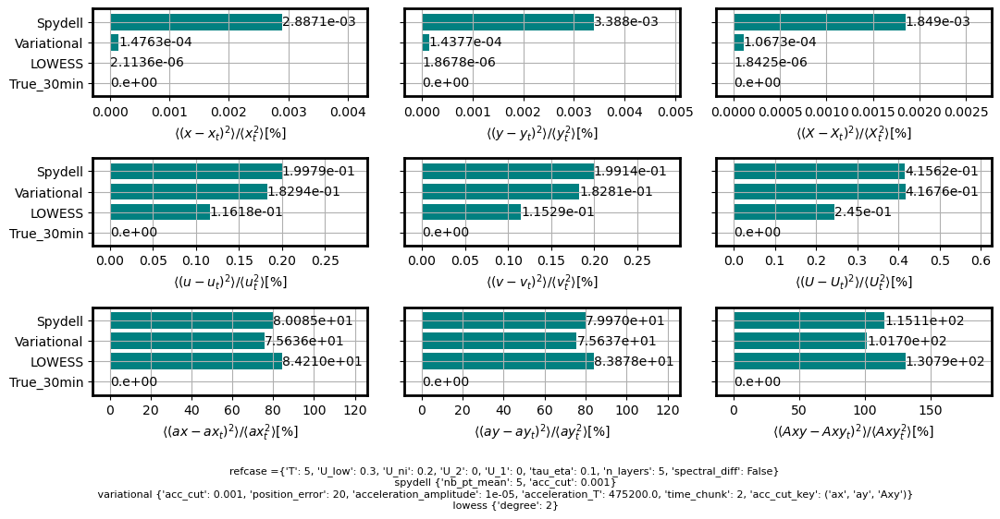

In [53]:
fig, axs = plt.subplots(3,3, sharey=True, figsize = (11,5))
i=0
axs = axs.flatten()
for var in ['x', 'y','X', 'u','v','U','ax','ay', 'Axy'] : 
    ax=axs[i]
    dfr[var].plot.barh(ax=ax, color ='teal', width =0.8)
    ax.grid()
    ax.set_xlim(-0.1*dfr[var].max(), dfr[var].max()*1.5)
    i+=1
    ax.set_xlabel(fr'$\langle ({var}-{var}_t)^2 \rangle / \langle {var}_t^2 \rangle [\%]$')
    ax.bar_label(ax.containers[0], labels =[ np.format_float_scientific(l,precision = 4, exp_digits=2) for l in dfr[var].values])
fig.tight_layout()
fig.suptitle('refcase =' +str(ref_case) + '\n spydell ' +str(parameters_spydell)+'\n variational '+str(parameters_var)+'\n lowess '+str(parameters_lowess),
            x= 0.5, y=-0.02, fontsize=8)
path = os.path.join('/home1/datahome/mdemol/PhD/campaign/images', "spaguetti_fig.png")
fig.savefig(path, dpi=250)

True_1min
True_30min
LOWESS
Variational
Spydell


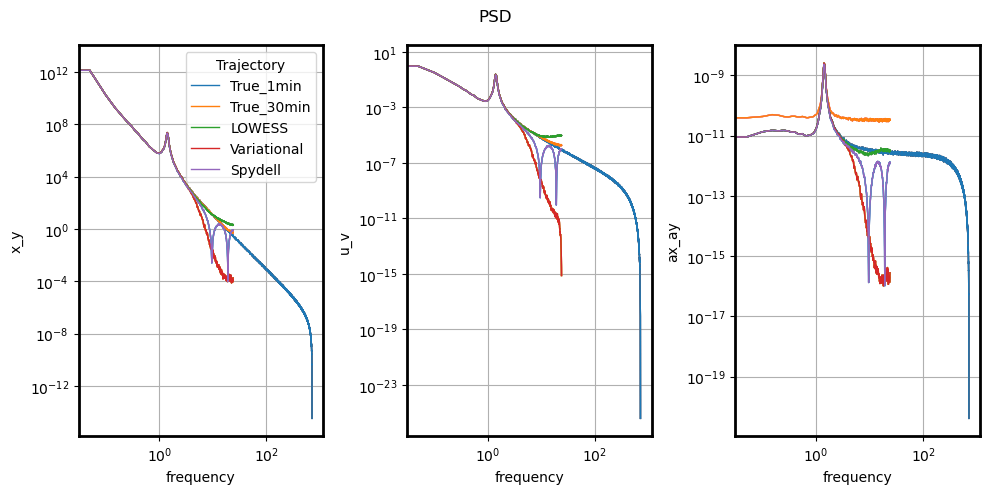

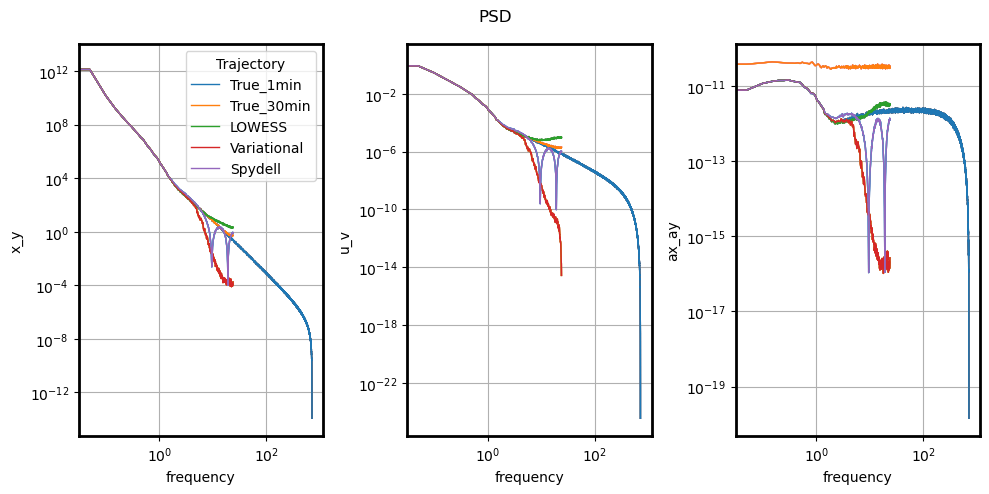

In [34]:
#DF.pop('True_1min')
DSE = st.spectrum_DF(DF, nperseg='20D', detrend = 'linear')
dse = st.DSE2dse(DSE)
dsen, dsep = st.negpos_spectra(dse)


fig4, axs = plt.subplots(1, 3, figsize=(10,5))

for l in dsen.Trajectory :
    dsen.x_y.mean('id').plot(hue='Trajectory', ax=axs[0], add_legend=True, lw=1)
    dsen.u_v.mean('id').plot(hue='Trajectory', ax=axs[1], add_legend=False, lw=1)
    dsen.ax_ay.mean('id').plot(hue='Trajectory', ax=axs[2], add_legend=False, lw=1)
for ax in axs :
    ax.grid()
    ax.set_xscale('log')
    ax.set_yscale('log')
fig4.suptitle("PSD")
fig4.tight_layout()

fig4, axs = plt.subplots(1, 3, figsize=(10,5))

for l in dsep.Trajectory :
    dsep.x_y.mean('id').plot(hue='Trajectory', ax=axs[0], add_legend=True, lw=1)
    dsep.u_v.mean('id').plot(hue='Trajectory', ax=axs[1], add_legend=False, lw=1)
    dsep.ax_ay.mean('id').plot(hue='Trajectory', ax=axs[2], add_legend=False, lw=1)
for ax in axs :
    ax.grid()
    ax.set_xscale('log')
    ax.set_yscale('log')
fig4.suptitle("PSD")
fig4.tight_layout()

In [24]:
DF_diff = st.build_DF_diff(DF, true_key='True_30min')

Observed has not the same time index


LOWESS
Variational
Spydell


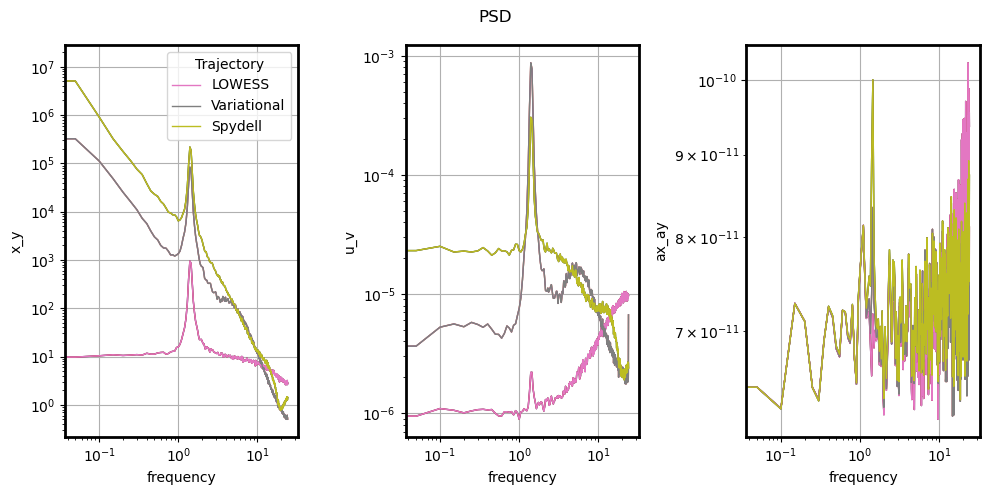

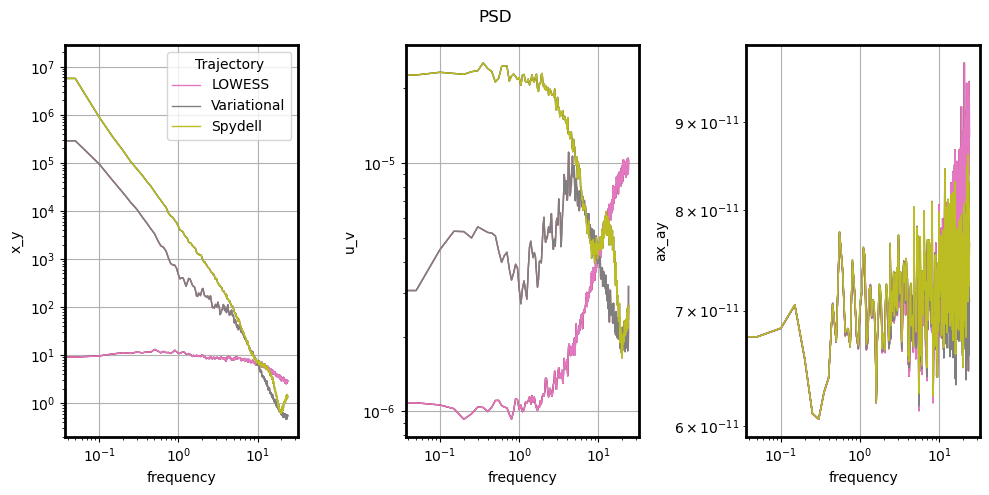

In [25]:
DSEd = st.spectrum_DF(DF_diff, nperseg='20D', detrend = 'linear')
dsed = st.DSE2dse(DSEd)
dsend, dsepd = st.negpos_spectra(dsed)


fig4, axs = plt.subplots(1, 3, figsize=(10,5))

for l in dsend.Trajectory :
    dsend.x_y.mean('id').plot(hue='Trajectory', ax=axs[0], add_legend=True, lw=1)
    dsend.u_v.mean('id').plot(hue='Trajectory', ax=axs[1], add_legend=False, lw=1)
    dsend.ax_ay.mean('id').plot(hue='Trajectory', ax=axs[2], add_legend=False, lw=1)
for ax in axs :
    ax.grid()
    ax.set_xscale('log')
    ax.set_yscale('log')
fig4.suptitle("PSD")
fig4.tight_layout()

fig4, axs = plt.subplots(1, 3, figsize=(10,5))

for l in dsepd.Trajectory :
    dsepd.x_y.mean('id').plot(hue='Trajectory', ax=axs[0], add_legend=True, lw=1)
    dsepd.u_v.mean('id').plot(hue='Trajectory', ax=axs[1], add_legend=False, lw=1)
    dsepd.ax_ay.mean('id').plot(hue='Trajectory', ax=axs[2], add_legend=False, lw=1)
for ax in axs :
    ax.grid()
    ax.set_xscale('log')
    ax.set_yscale('log')
fig4.suptitle("PSD")
fig4.tight_layout()

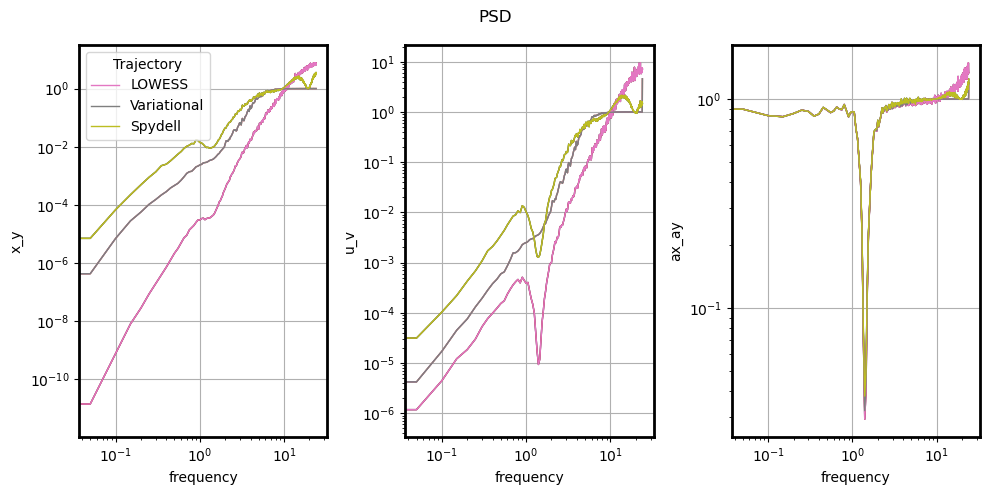

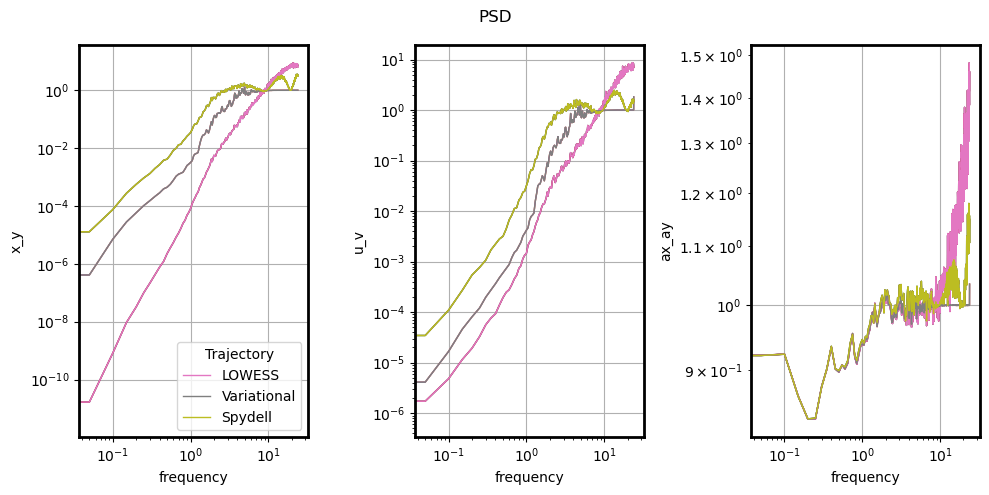

In [26]:
dsend =dsend/dsen.sel(Trajectory = 'True_30min')
dsepd = dsepd/dsep.sel(Trajectory = 'True_30min')


fig4, axs = plt.subplots(1, 3, figsize=(10,5))

for l in dsend.Trajectory :
    dsend.x_y.mean('id').plot(hue='Trajectory', ax=axs[0], add_legend=True, lw=1)
    dsend.u_v.mean('id').plot(hue='Trajectory', ax=axs[1], add_legend=False, lw=1)
    dsend.ax_ay.mean('id').plot(hue='Trajectory', ax=axs[2], add_legend=False, lw=1)
for ax in axs :
    ax.grid()
    ax.set_xscale('log')
    ax.set_yscale('log')
fig4.suptitle("PSD")
fig4.tight_layout()

fig4, axs = plt.subplots(1, 3, figsize=(10,5))

for l in dsepd.Trajectory :
    dsepd.x_y.mean('id').plot(hue='Trajectory', ax=axs[0], add_legend=True, lw=1)
    dsepd.u_v.mean('id').plot(hue='Trajectory', ax=axs[1], add_legend=False, lw=1)
    dsepd.ax_ay.mean('id').plot(hue='Trajectory', ax=axs[2], add_legend=False, lw=1)
for ax in axs :
    ax.grid()
    ax.set_xscale('log')
    ax.set_yscale('log')
fig4.suptitle("PSD")
fig4.tight_layout()